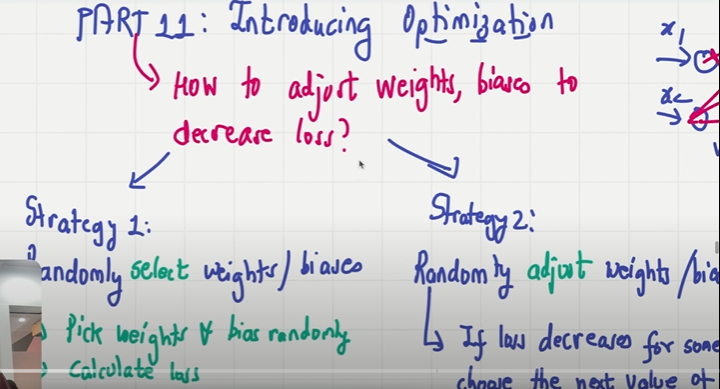

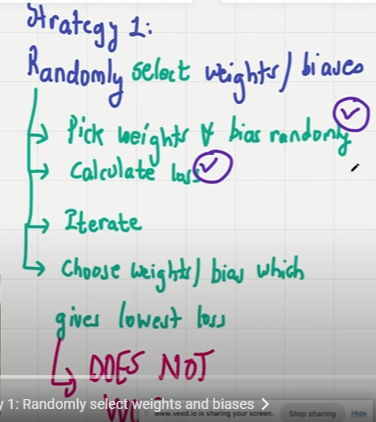

In [2]:

from nnfs.datasets import vertical_data
import matplotlib.pyplot as  plt
import numpy as np
import nnfs
nnfs.init()

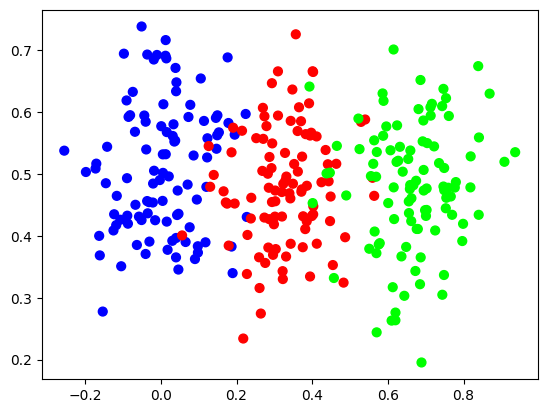

In [3]:
X, y = vertical_data(samples=100, classes=3)
plt.scatter(X[:,0],X[:,1],c=y,s=40,cmap='brg')
plt.show()

In [4]:
from Dense_Layer import Layer_Dense
from ReLU_Act import Activation_ReLU
from Softmax_Act import Activation_Softmax
from Cat_Crossentropy_Loss import Loss_Categorical_Crossentropy

strategy1:randomly select weights and biases - does not work

In [12]:
# Create dataset
X,y = vertical_data(samples=100, classes=3)
#create model
dense1 = Layer_Dense(2,3) # first dense layer , 2 input feature  3 neuron output
activation1 = Activation_ReLU()

dense2 = Layer_Dense(3,3) # second dense layer , 3 input feature  3 neuron output
activation2 = Activation_Softmax()

# loss function
loss = Loss_Categorical_Crossentropy()

#Helper variables
n_iteration = 0
lowest_loss = 9999999 # some initial value
best_dense1_weights = dense1.weights.copy() # initialize random weight
best_dense1_biases = dense1.biases.copy()

best_dense2_weights = dense2.weights.copy()
best_dense2_biases = dense2.biases.copy()

# training loop iteraion > epoch learning rate ==0.05
for iteration in range(100): # no of iteraion must shuld be 1000 as minimum
    # generate a new set of weights for iteration
    dense1.weights = 0.05 * np.random.randn(2,3)  # crate 2x3 matrix for 2 input feature and 3 output neuron
    dense1.biases = 0.05 * np.random.randn(3)  # create 3x1 matrix for 3 output neuron
    
    dense2.weights = 0.05 * np.random.randn(3,3)
    dense2.biases = 0.05 * np.random.randn(3)
    
    # forward pass
    dense1.forward(X)
    activation1.forward(dense1.output)
    dense2.forward(activation1.output)
    activation2.forward(dense2.output)

    # calculate loss
    loss_value = loss.calculate(activation2.output, y)

    #calculate accuracy from output of activation2
    predictions = np.argmax(activation2.output, axis=1)
    accuracy = np.mean(predictions == y)

    #if loss is smaaller -print and save weights and biases aside
    if loss_value < lowest_loss:
        best_dense1_weights = dense1.weights.copy()
        best_dense1_biases = dense1.biases.copy()
        best_dense2_weights = dense2.weights.copy()
        best_dense2_biases = dense2.biases.copy()
        n_iteration = iteration
        lowest_loss = loss_value
        print(f"Iteration: {iteration}, Loss: {loss_value:.4f}, Accuracy: {accuracy:.4f}")

    # print(f"Iteration: {iteration}, Loss: {loss_value:.4f}, Accuracy: {accuracy:.4f}")
print("*******")
print(f'iteration:{n_iteration}')
print(best_dense1_weights,best_dense1_biases)
print(best_dense2_weights, best_dense2_biases)


Iteration: 0, Loss: 1.0999, Accuracy: 0.3333
Iteration: 1, Loss: 1.0988, Accuracy: 0.3333
Iteration: 8, Loss: 1.0984, Accuracy: 0.3333
Iteration: 18, Loss: 1.0980, Accuracy: 0.3333
Iteration: 59, Loss: 1.0973, Accuracy: 0.3333
Iteration: 79, Loss: 1.0969, Accuracy: 0.3333
*******
iteration:79
[[ 0.11970185  0.0826384   0.10090806]
 [ 0.00334842  0.13682376 -0.05064983]] [ 0.01358309 -0.00544986 -0.00286296]
[[-5.2946564e-02 -1.6326422e-02  1.6502295e-02]
 [-2.3998973e-05  4.0905796e-02  2.1410687e-02]
 [-1.2519737e-01  6.0240566e-03  4.0394645e-02]] [ 0.03010605 -0.0432595  -0.00766602]


STRATEGY 2 

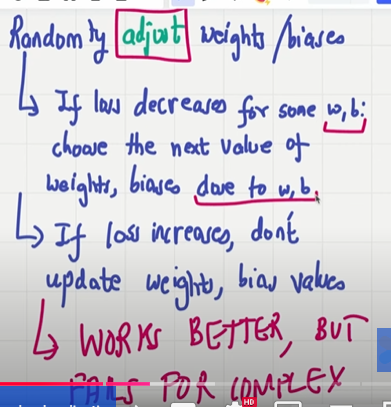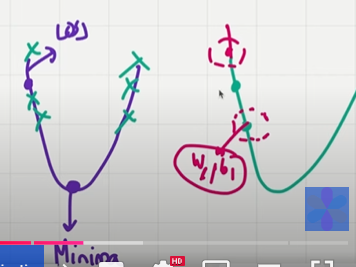

In [6]:
# Create dataset
X,y = vertical_data(samples=100, classes=3)
#create model
dense1 = Layer_Dense(2,3) # first dense layer , 2 input feature  3 neuron output
activation1 = Activation_ReLU()

dense2 = Layer_Dense(3,3) # second dense layer , 3 input feature  3 neuron output
activation2 = Activation_Softmax()

# loss function
loss = Loss_Categorical_Crossentropy()

#Helper variables
n_iteration = 0
lowest_loss = 9999999 # some initial value
best_dense1_weights = dense1.weights.copy() # initialize random weight
best_dense1_biases = dense1.biases.copy()

best_dense2_weights = dense2.weights.copy()
best_dense2_biases = dense2.biases.copy()

# training loop iteraion > epoch learning rate ==0.05
for iteration in range(100): # no of iteraion must shuld be 1000 as minimum
    # generate a new set of weights for iteration
    dense1.weights += 0.05 * np.random.randn(2,3)  # crate 2x3 matrix for 2 input feature and 3 output neuron
    dense1.biases += 0.05 * np.random.randn(3)  # create 3x1 matrix for 3 output neuron
    
    dense2.weights += 0.05 * np.random.randn(3,3)
    dense2.biases += 0.05 * np.random.randn(3)
    
    # forward pass
    dense1.forward(X)
    activation1.forward(dense1.output)
    dense2.forward(activation1.output)
    activation2.forward(dense2.output)

    # calculate loss
    loss_value = loss.calculate(activation2.output, y)

    #calculate accuracy from output of activation2
    predictions = np.argmax(activation2.output, axis=1)
    accuracy = np.mean(predictions == y)

    #if loss is smaaller -print and save weights and biases aside
    if loss_value < lowest_loss:
        best_dense1_weights = dense1.weights.copy()
        best_dense1_biases = dense1.biases.copy()
        best_dense2_weights = dense2.weights.copy()
        best_dense2_biases = dense2.biases.copy()
        n_iteration = iteration
        lowest_loss = loss_value
        print(f"Iteration: {iteration}, Loss: {loss_value:.4f}, Accuracy: {accuracy:.4f}")

    # print(f"Iteration: {iteration}, Loss: {loss_value:.4f}, Accuracy: {accuracy:.4f}")
print("*******")
print(f'iteration:{n_iteration}')
print(best_dense1_weights,best_dense1_biases)
print(best_dense2_weights, best_dense2_biases)


Iteration: 0, Loss: 1.0988, Accuracy: 0.3333
Iteration: 28, Loss: 1.0965, Accuracy: 0.3400
Iteration: 31, Loss: 1.0951, Accuracy: 0.3333
Iteration: 32, Loss: 1.0950, Accuracy: 0.4600
Iteration: 33, Loss: 1.0942, Accuracy: 0.3467
Iteration: 42, Loss: 1.0938, Accuracy: 0.3333
Iteration: 54, Loss: 1.0777, Accuracy: 0.3333
Iteration: 55, Loss: 1.0758, Accuracy: 0.3333
Iteration: 56, Loss: 1.0733, Accuracy: 0.3333
Iteration: 59, Loss: 1.0667, Accuracy: 0.4000
Iteration: 60, Loss: 1.0582, Accuracy: 0.3467
*******
iteration:60
[[-0.41314822 -0.38307732 -0.22201058]
 [-0.21790875  0.5529874   0.14420748]] [[ 0.37545067  0.3905405  -0.1015617 ]]
[[ 0.23768665  0.12034482 -0.1282901 ]
 [ 0.40411073  0.14429863 -0.4614359 ]
 [ 0.24363177  0.03315382  0.3079771 ]] [[-0.2937942  -0.45566037 -0.0345571 ]]


### Grdient Decent Technique Back propagation

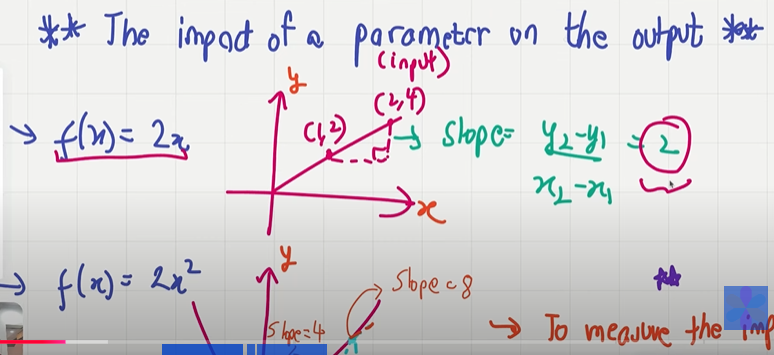

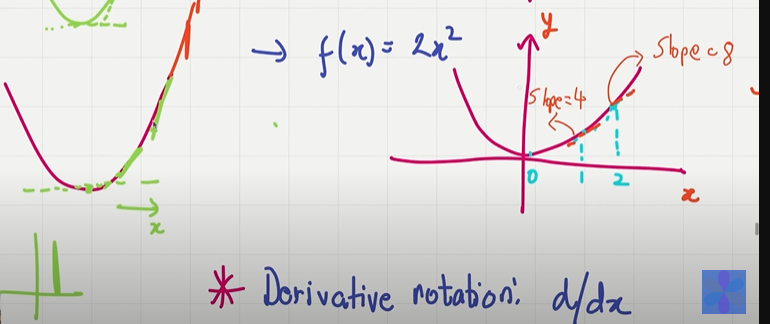

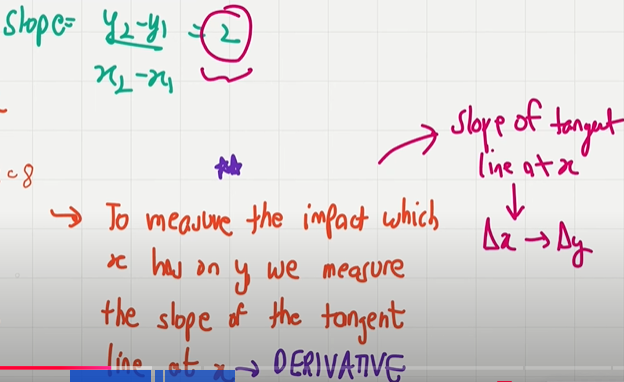

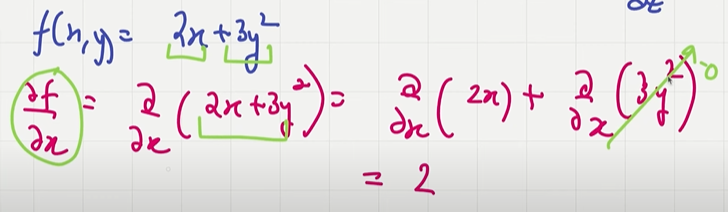

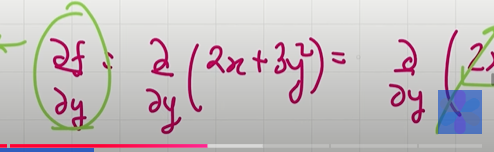

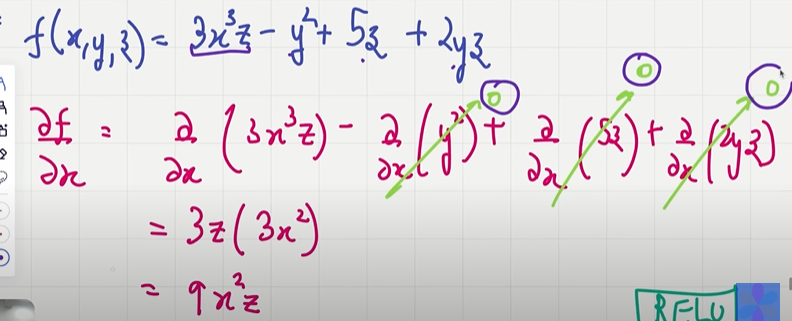

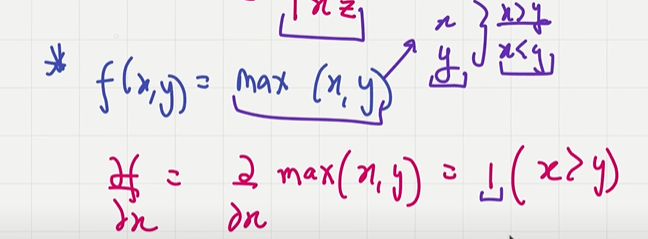

18:48

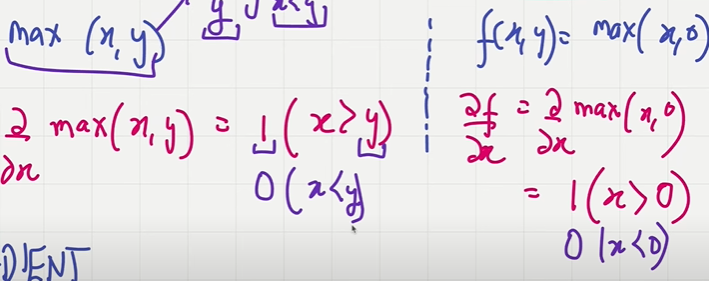

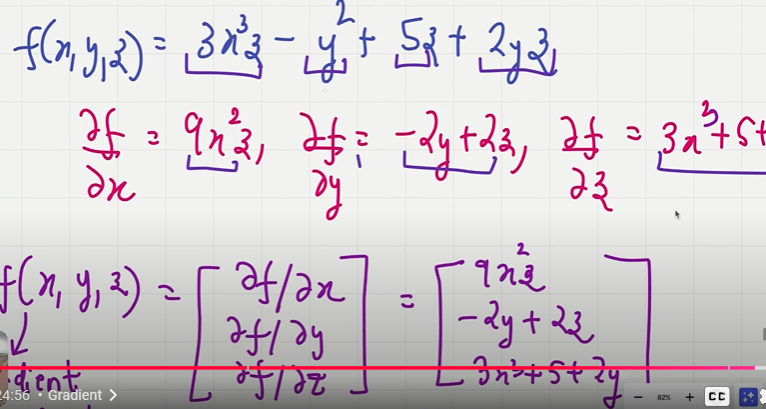

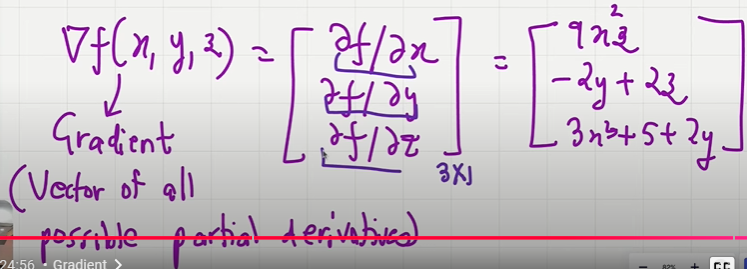

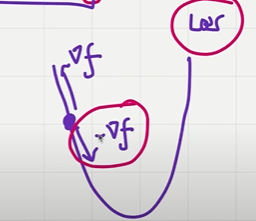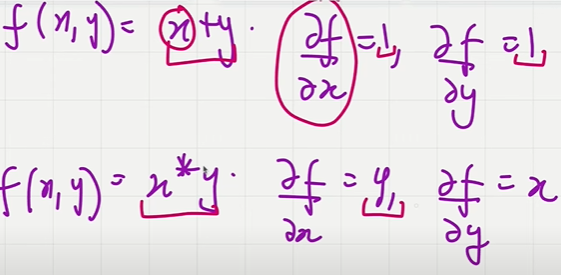


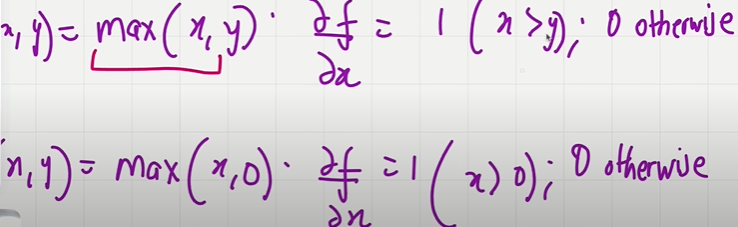

chain rule backpropagation

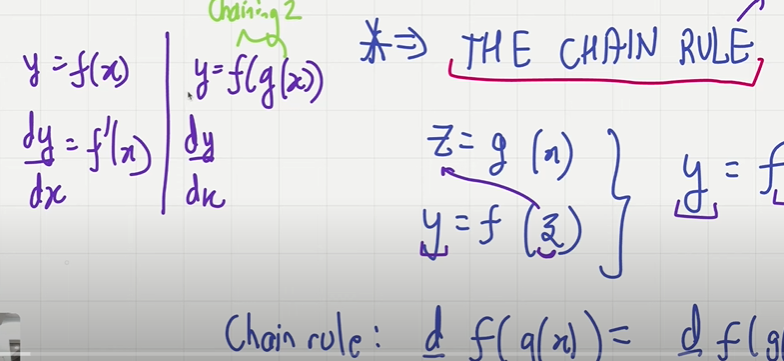

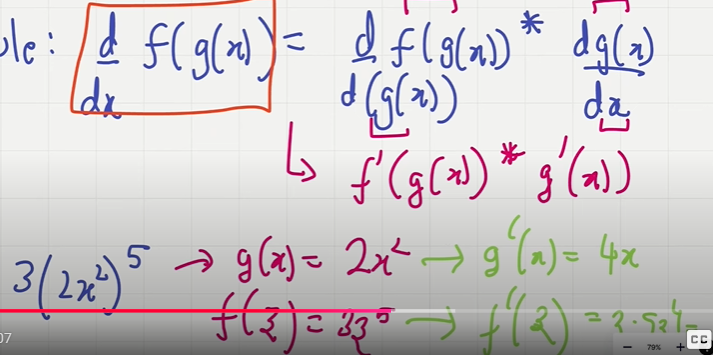


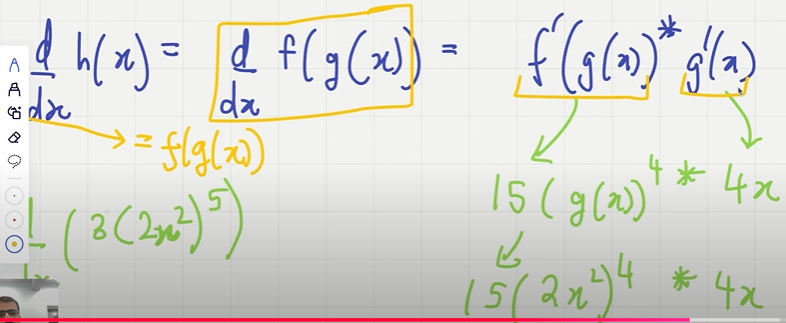

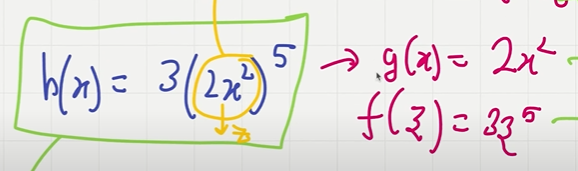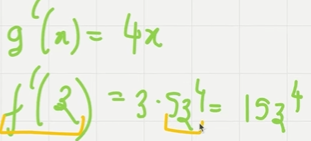
...

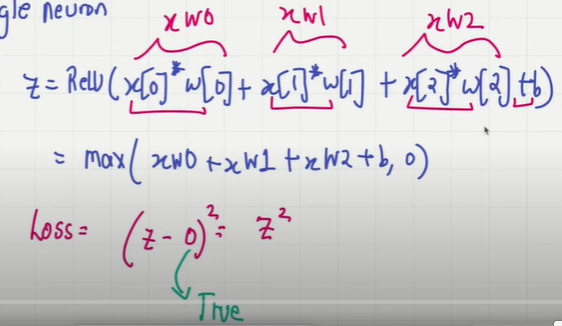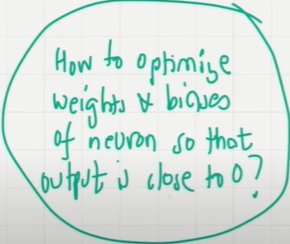

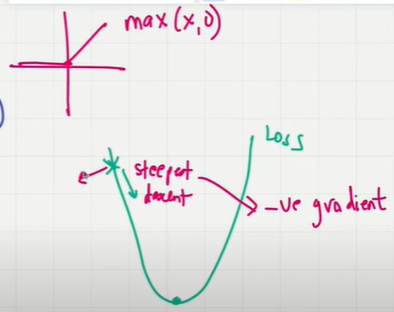

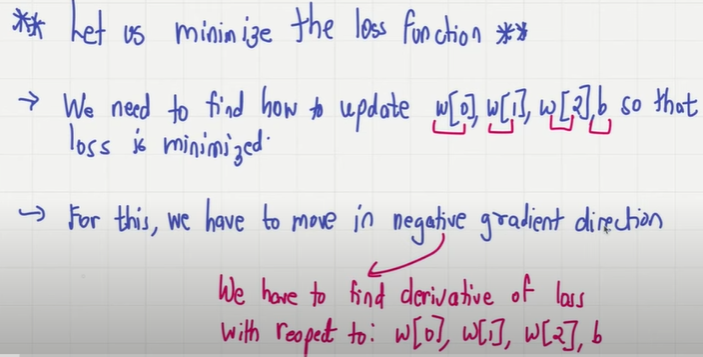

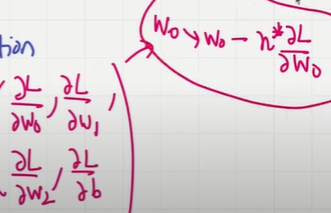

dl/dw0 rate of change of loss wrt weight > loss per unit weight  > to find minimum loss per unit weight

0(theta) shift towards 0 or 180 >> tan0=dl/dw shift towards 0 

w0 decrease >> dl/dw0 decrese tan0 decrase >> 10(dl) in 0.5(dw) ,6(dl)  in 0.7(dw) ,2(dl) in 1(dw), 7(dl) in 1.5(dw) min loss at weight 1

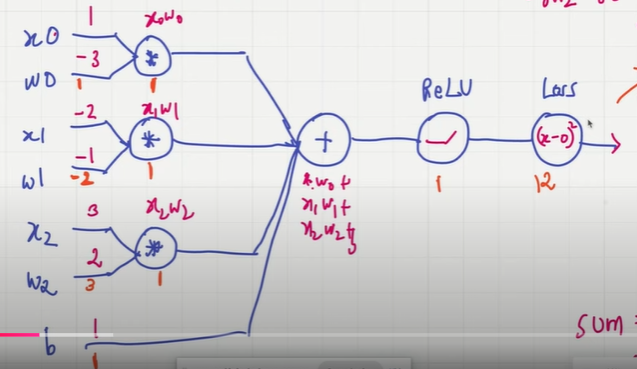

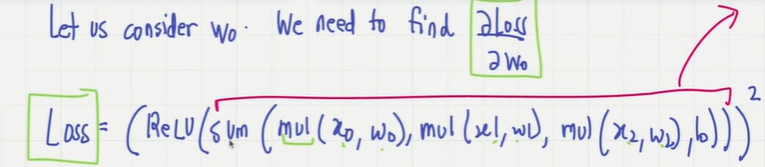

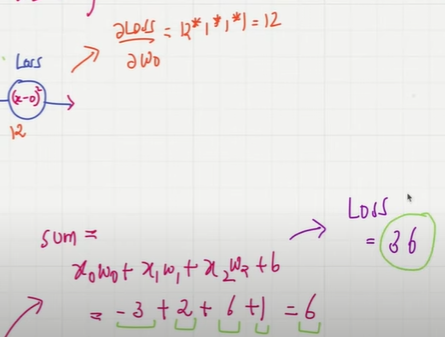

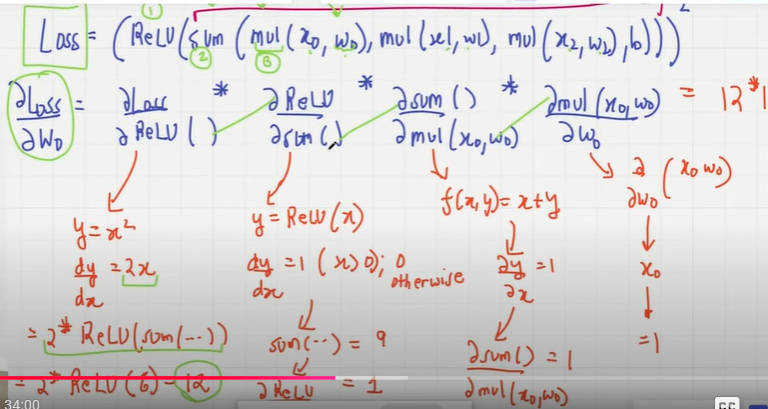

y = loss, x = Relu || y = Relu, x = sum() || y = sum() , x =mul() || y = mul() , x = w0

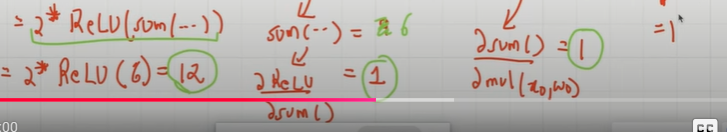

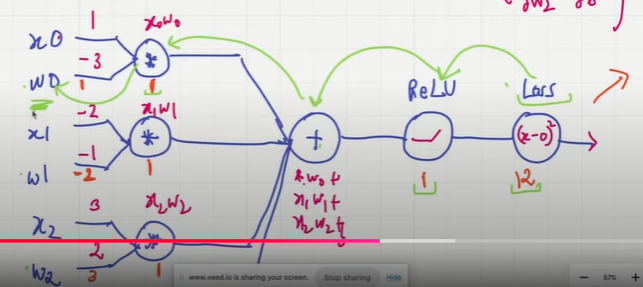

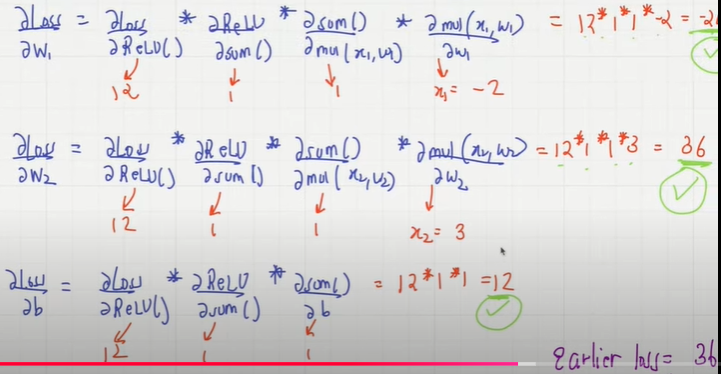

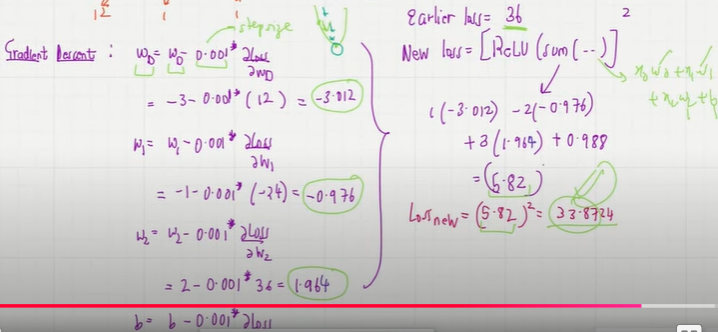

Backpropagation for single neuron

In [1]:
import numpy as np

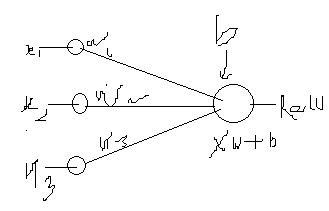

In [5]:
#initial parameters
weights = np.array([-3.0, -1.0, 2.0])
bias = 1.0
inputs = np.array([1.0, -2.0, 3.0])
target_output = 0.0  #single neuron
learning_rate = 0.001

In [3]:
def relu(x):
    return np.maximum(0,x)

In [4]:
def relu_derivative(x):
    return np.where(x > 0, 1.0, 0.0) # where  value > 0 replaced with 1 and if <= 0 replaced with 0

In [11]:
for iteration in range(50):
    print("iteration>>>",iteration)
    # forward pass
    linear_output = np.dot(inputs, weights) + bias # 
    # print(linear_output)
    output = relu(linear_output) # if < 0 then 0 rather as it is 
    # print(output)

    loss = (output-target_output)**2 # to make positive
    # print(loss)

    # backward pass > derivative d
    dloss_doutput = 2*(output-target_output) 
    # print(dloss_doutput)
    doutput_dlinear = relu_derivative(linear_output)
    # print(doutput_dlinear)
    dlinear_dweights = inputs # dlinear/dw = d/dw(x*w) = x (input) as vecto form [x1, x2, x3]
    # print(dlinear_dweights)
    dlinear_dbias = 1

    dloss_dweights = np.dot(dlinear_dweights.T, dloss_doutput*doutput_dlinear) # np broadcast for 2nd part
    # print(dloss_dweights)
    
    dloss_dbias = np.sum(dloss_doutput*doutput_dlinear, axis=0)
    # print(dloss_dbias)

    weights -= learning_rate*dloss_dweights
    # print(weights)
    bias -= learning_rate*dloss_dbias
    # print(bias)
    print(f"Iteratin:{iteration} = loss:{loss}")


iteration>>> 0
Iteratin:0 = loss:0.930916252865338
iteration>>> 1
Iteratin:1 = loss:0.8758991023209968
iteration>>> 2
Iteratin:2 = loss:0.8241334653738256
iteration>>> 3
Iteratin:3 = loss:0.7754271775702323
iteration>>> 4
Iteratin:4 = loss:0.7295994313758316
iteration>>> 5
Iteratin:5 = loss:0.6864801049815187
iteration>>> 6
Iteratin:6 = loss:0.6459091307771115
iteration>>> 7
Iteratin:7 = loss:0.6077359011481847
iteration>>> 8
Iteratin:8 = loss:0.571818709390327
iteration>>> 9
Iteratin:9 = loss:0.5380242236653578
iteration>>> 10
Iteratin:10 = loss:0.5062269920467349
iteration>>> 11
Iteratin:11 = loss:0.47630897681677353
iteration>>> 12
Iteratin:12 = loss:0.4481591162869011
iteration>>> 13
Iteratin:13 = loss:0.4216729125143454
iteration>>> 14
Iteratin:14 = loss:0.3967520433847474
iteration>>> 15
Iteratin:15 = loss:0.3733039976207088
iteration>>> 16
Iteratin:16 = loss:0.35124173136132436
iteration>>> 17
Iteratin:17 = loss:0.3304833450378702
iteration>>> 18
Iteratin:18 = loss:0.31095177934

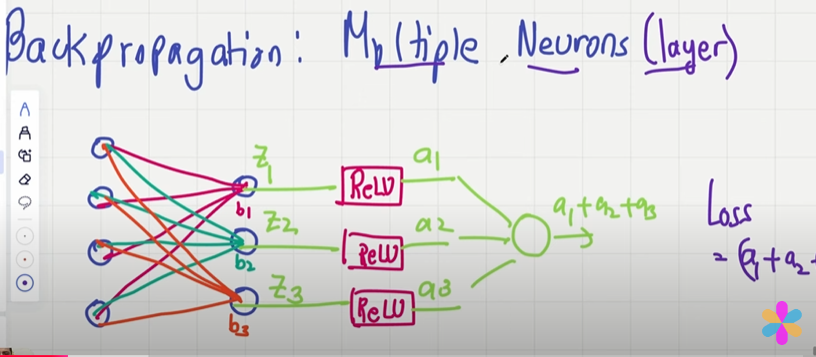

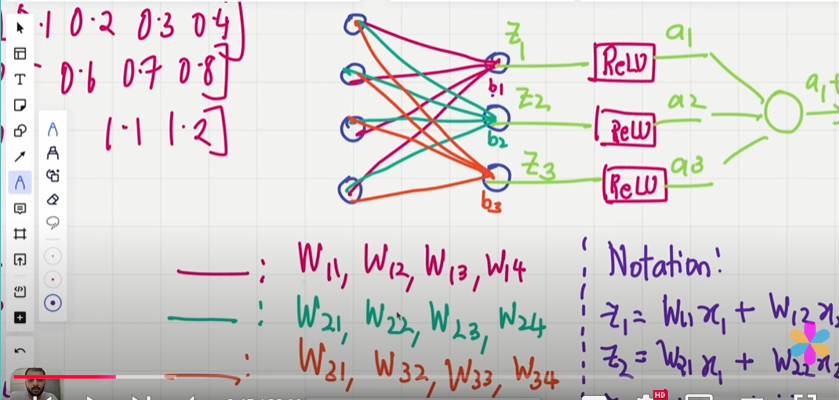

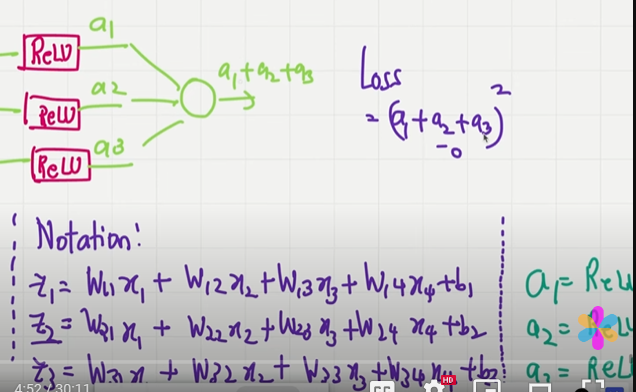

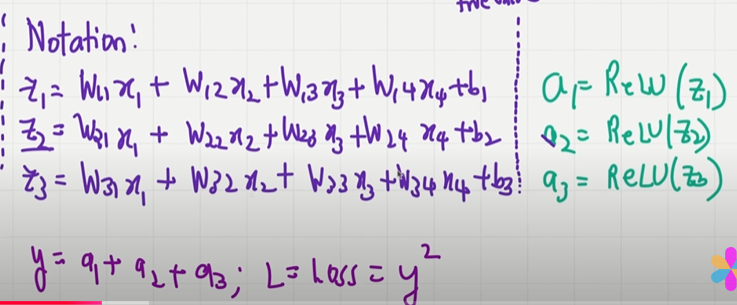

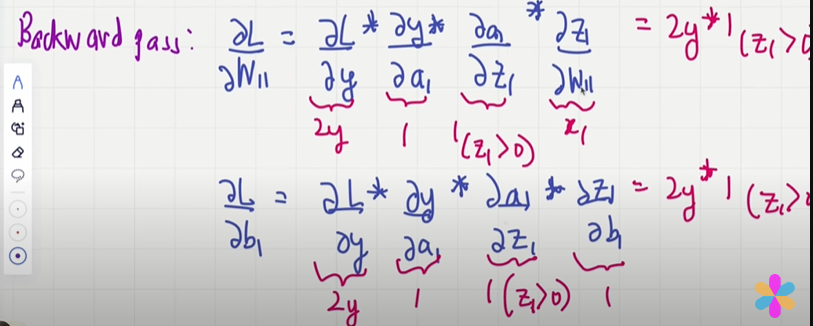

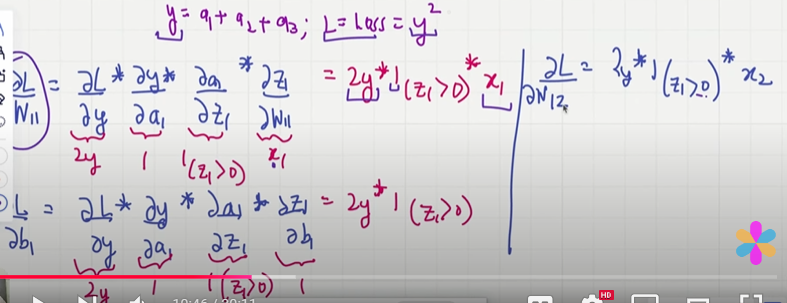

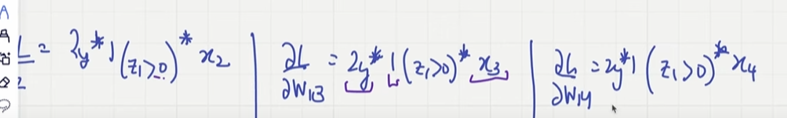

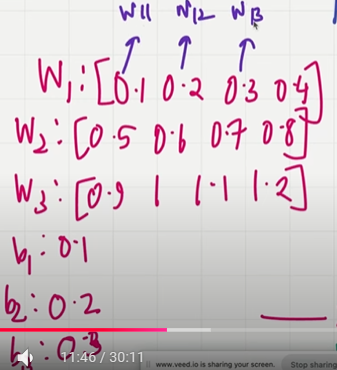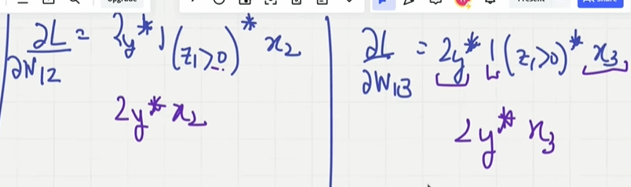

w1 , b1 for 1st neuron w2, b2 for 2nd neuron and w3 , b3 for 3rd neuron

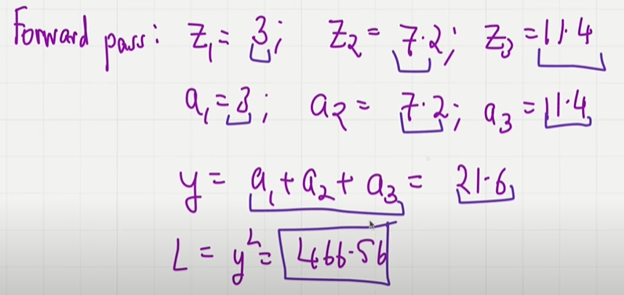

for 1st neuron

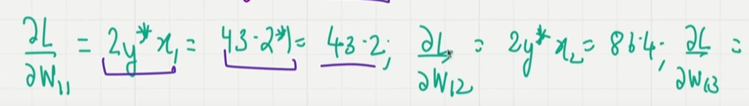

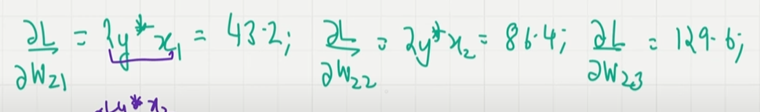


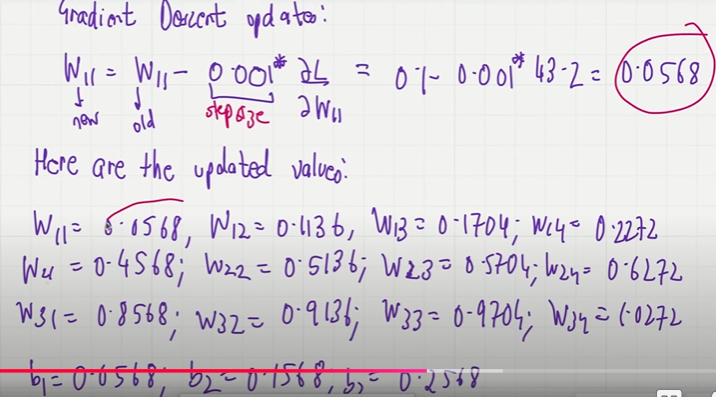

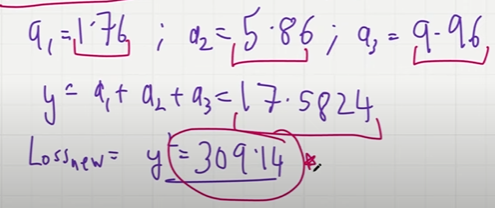

Backword pass for multiple neurrdon

In [1]:
import numpy as np

In [2]:
#initial parameters
inputs = np.array([1, 2, 3, 4])

# for 3 neuron
biases = np.array([0.1, 0.2, 0.3])

weights = np.array([
    [1.0, 2.0, 3.0, 4.0],
    [0.5, 0.6, 0.7, 0.8],
    [0.9, 1.0, 1.1, 1.2]
    ])

target_output = 0.0  #single neuron

learning_rate = 0.001

In [3]:
#relu activation function and its derivatives
def relu(x):
    return np.maximum(0,x)

In [4]:
def relu_derivative(x):
    return np.where(x > 0, 1.0, 0.0) # where  value > 0 replaced with 1 and if <= 0 replaced with 0

In [10]:
#Training Loop
for iteration in range(100):
    # forward p
    z = np.dot(weights, inputs) + biases
    a = relu(z)
    y = np.sum(a)

    #calculate loss
    loss = y ** 2

    # Backward pass
    # Gradient of loss wrt output y
    dL_dy = 2 * y

    # Gradient of y wrt a
    dy_da = np.ones_like(a) #np.ones_like() is a NumPy function that returns an 
    # array of ones with the same shape and type as the input array.

    # gradient of loss wrt a
    dL_da = dL_dy * dy_da

    # Gradient of a wrt z(relu derivative)
    da_dz = relu_derivative(z)

    # Gradient of loss wrt z
    dL_dz = dL_da * da_dz

    # Gradient of z wrt weights ## outer is partial derivative  d/dw(xw) = x
    dL_dw = np.outer(dL_dz, inputs) #np.outer() is a NumPy function that computes the outer product of two vectors.

    # a = np.array([1, 2, 3])
    # b = np.array([4, 5])
    # # Compute outer product
    # outer_product = np.outer(a, b)
    # [[ 4  5]
    # [ 8 10]
    # [12 15]]
    
    # Gradient of z wrt biases
    dL_db = np.sum(dL_dz, axis=0) 

    # update weights and biases
    weights -= learning_rate * dL_dw
    biases -= learning_rate * dL_db

    # print(f"Iteration: {iteration}, Loss: {loss}")

    #print  loss of every 20 iterations
    if iteration % 10 == 0:
        print(f"Iteration: {iteration}, Loss: {loss}")

print(f"Iteration: {iteration}, Loss: {loss}")
print("Final weights: ", weights)
print("Final biases: ", biases)

 

Iteration: 0, Loss: 1.106379391724732e-25
Iteration: 10, Loss: 3.0848455002474243e-26
Iteration: 20, Loss: 8.573389621748533e-27
Iteration: 30, Loss: 2.3646598672065592e-27
Iteration: 40, Loss: 6.865062027685855e-28
Iteration: 50, Loss: 1.9568680830138724e-28
Iteration: 60, Loss: 5.69952004022181e-29
Iteration: 70, Loss: 1.779867417404908e-29
Iteration: 80, Loss: 4.930380657631324e-30
Iteration: 90, Loss: 2.4158865222393487e-30
Iteration: 99, Loss: 2.4158865222393487e-30
Final weights:  [[ 0.04873301  0.09746603  0.14619904  0.19493205]
 [ 0.26232617  0.12465234 -0.01302149 -0.15069532]
 [ 0.52695042  0.25390083 -0.01914875 -0.29219834]]
Final biases:  [-1.4619904 -1.3619904 -1.2619904]


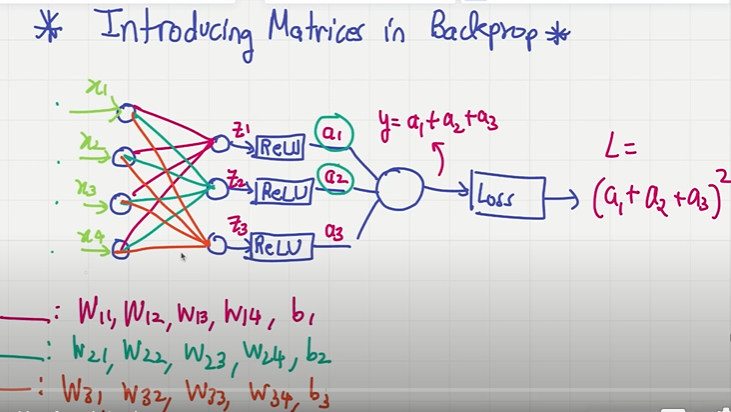

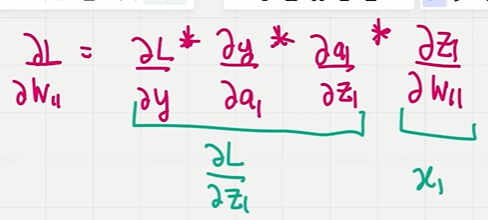

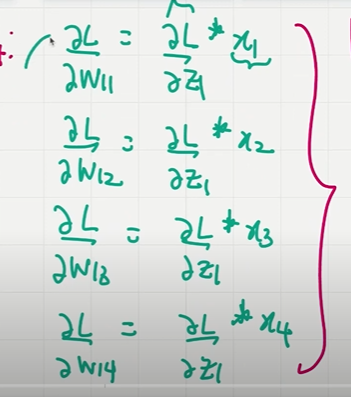

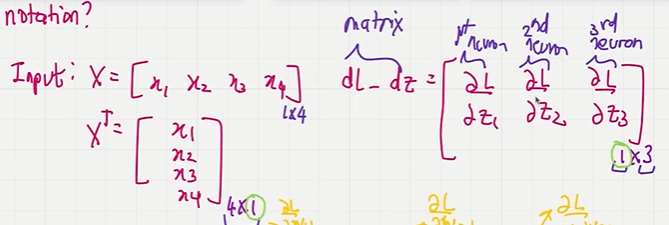

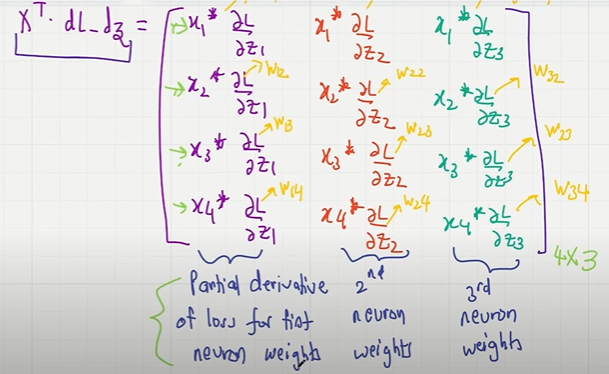
...

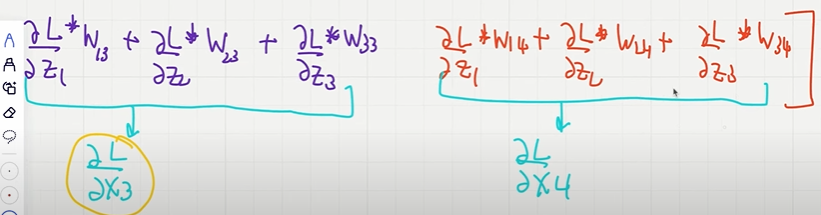

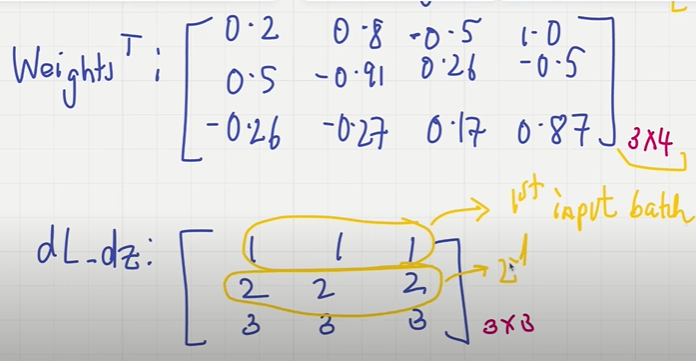

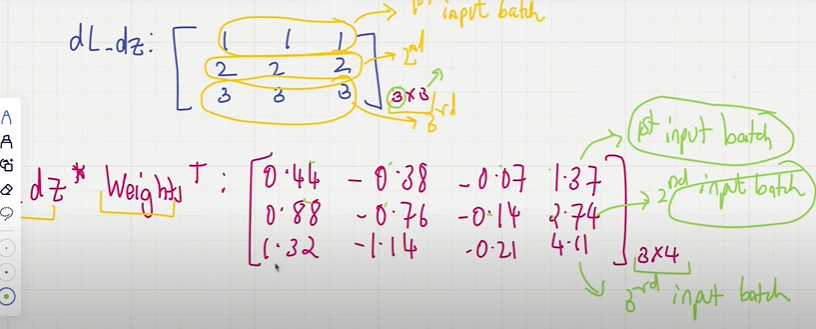

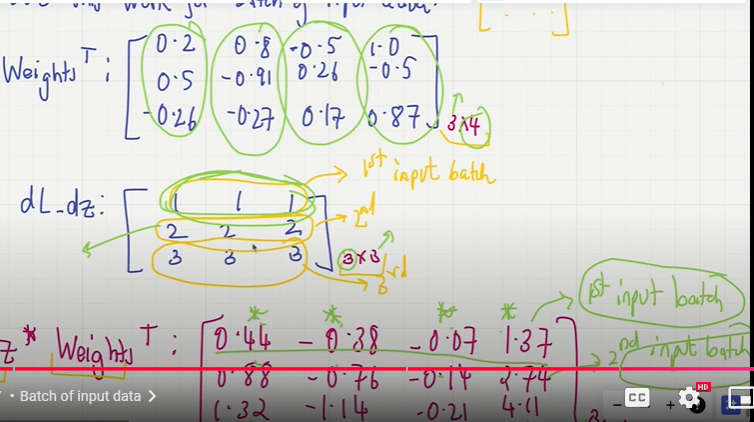

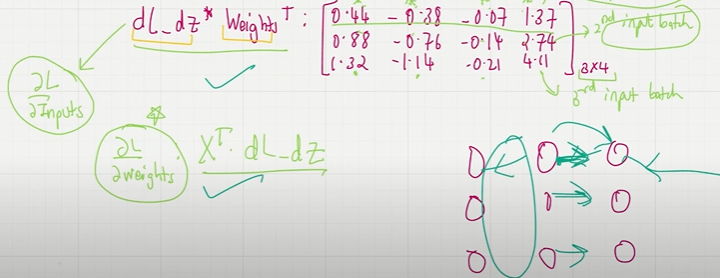

loss wrt weights here we need gradient of the loss wrt output of the previous layer neuron is the input of the next layer

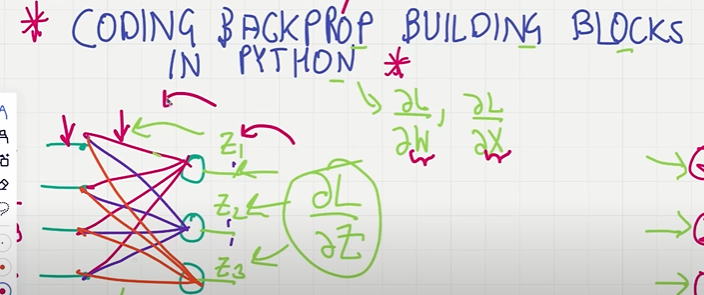

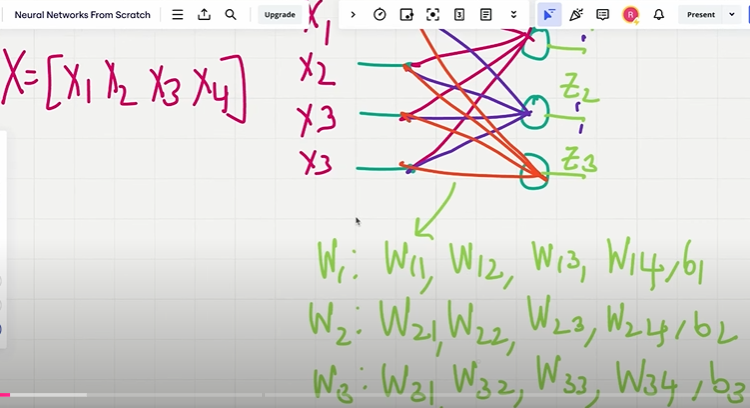

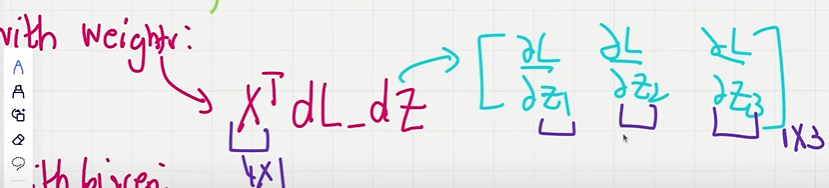

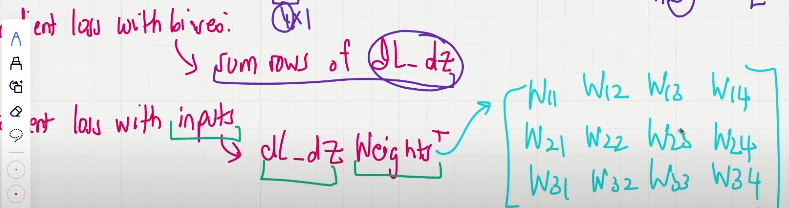

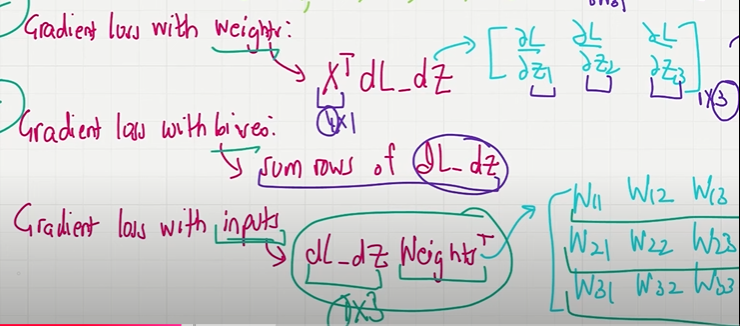

In [1]:
import numpy as np
# Passed-in gradient from the next layer
# for the purpose of this example we're going to use
# an array of an incremental gradient values
dvalues = np.array([[1., 1., 1.],  # dL_dz
 [2., 2., 2.],
 [3., 3., 3.]])
# We have 3 sets of inputs - samples
inputs = np.array([[1, 2, 3, 2.5],  # X
 [2., 5., -1., 2],
 [-1.5, 2.7, 3.3, -0.8]])
# sum weights of given input
# and multiply by the passed-in gradient for this neuron
dweights = np.dot(inputs.T, dvalues)
print(dweights)

[[ 0.5  0.5  0.5]
 [20.1 20.1 20.1]
 [10.9 10.9 10.9]
 [ 4.1  4.1  4.1]]


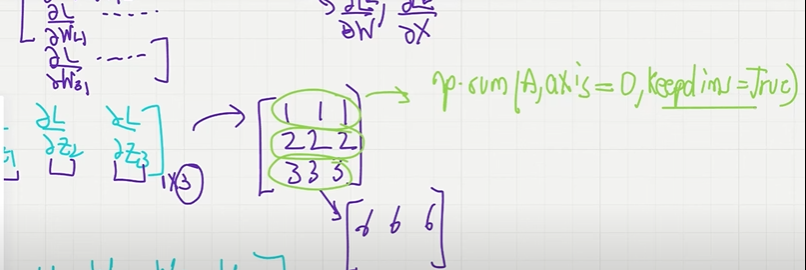

In [2]:
import numpy as np
# Passed-in gradient from the next layer
# for the purpose of this example we're going to use
# an array of an incremental gradient values
dvalues = np.array([[1., 1., 1.], # dL_dz
 [2., 2., 2.],
 [3., 3., 3.]])
# One bias for each neuron
# biases are the row vector with a shape (1, neurons)
biases = np.array([[2, 3, 0.5]])
# dbiases - sum values, do this over samples (first axis), keepdims
# since this by default will produce a plain list -
# we explained this in the chapter 4
dbiases = np.sum(dvalues, axis=0, keepdims=True)
print(dbiases)

[[6. 6. 6.]]


In [3]:
import numpy as np
# Passed-in gradient from the next layer
# for the purpose of this example we're going to use
# an array of an incremental gradient values
dvalues = np.array([[1., 1., 1.],  # derivative of inputs dL_dz
                    [2., 2., 2.],
                    [3., 3., 3.]])
# We have 3 sets of weights - one set for each neuron
# we have 4 inputs, thus 4 weights
# recall that we keep weights transposed
weights = np.array([[0.2, 0.8, -0.5, 1],
 [0.5, -0.91, 0.26, -0.5],
 [-0.26, -0.27, 0.17, 0.87]]).T
# sum weights of given input
# and multiply by the passed-in gradient for this neuron
dinputs = np.dot(dvalues, weights.T)
print(dinputs)

[[ 0.44 -0.38 -0.07  1.37]
 [ 0.88 -0.76 -0.14  2.74]
 [ 1.32 -1.14 -0.21  4.11]]


In [ ]:
# class Layer_Dense:
#  ...
#  # Backward pass
#  def backward(self, dvalues):
#  # Gradients on parameters
#  self.dweights = np.dot(self.inputs.T, dvalues)
#  self.dbiases = np.sum(dvalues, axis=0, keepdims=True)
#  # Gradient on values
#  self.dinputs = np.dot(dvalues, self.weights.T)

In [ ]:
# # ReLU activation
# class Activation_ReLU:
#  # Forward pass
#  def forward(self, inputs):
#  # Remember input values
#  self.inputs = inputs
#  self.output = np.maximum(0, inputs)
#  # Backward pass
#  def backward(self, dvalues):
#  # Since we need to modify the original variable,
#  # let's make a copy of the values first
#  self.dinputs = dvalues.copy()
#  # Zero gradient where input values were negative
#  self.dinputs[self.inputs <= 0] = 0

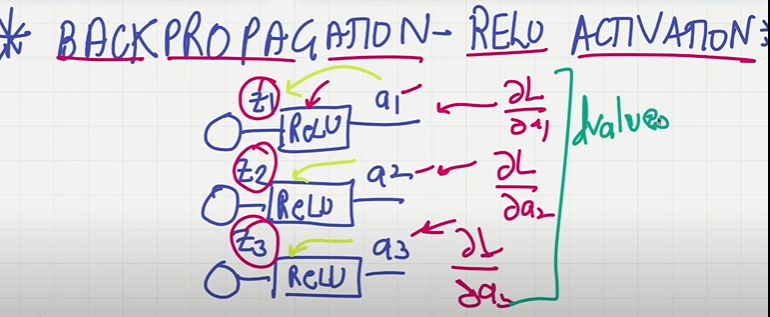

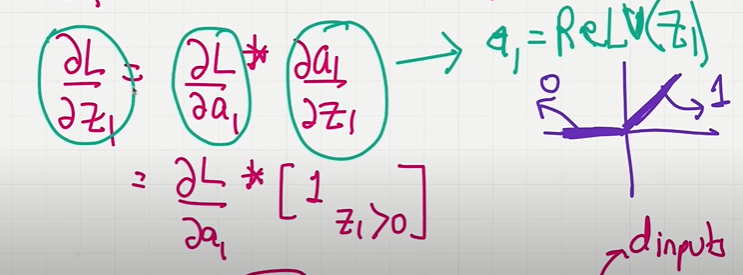

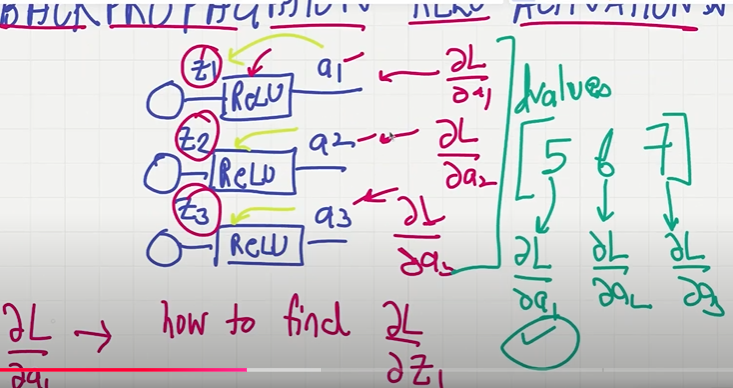

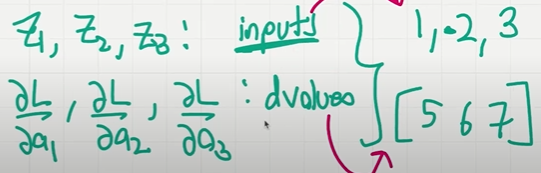

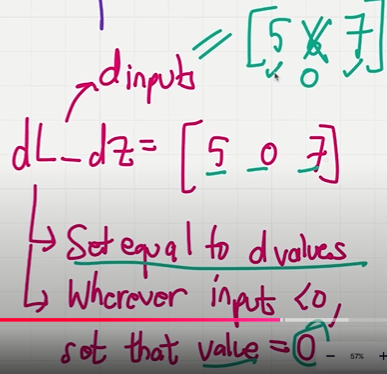

Categorical cross entropy

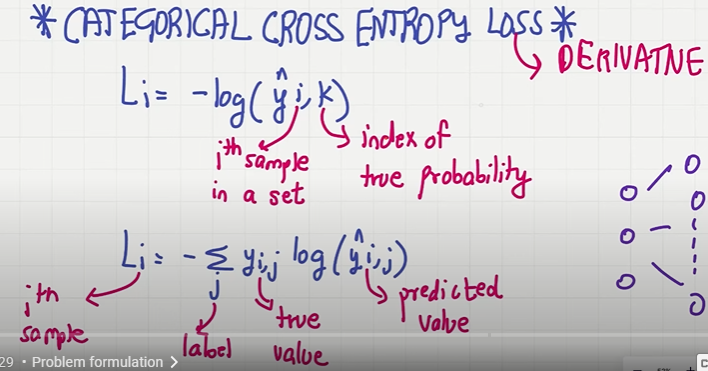

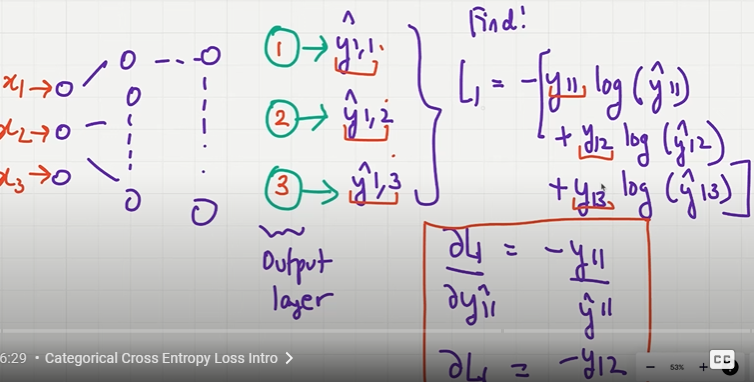

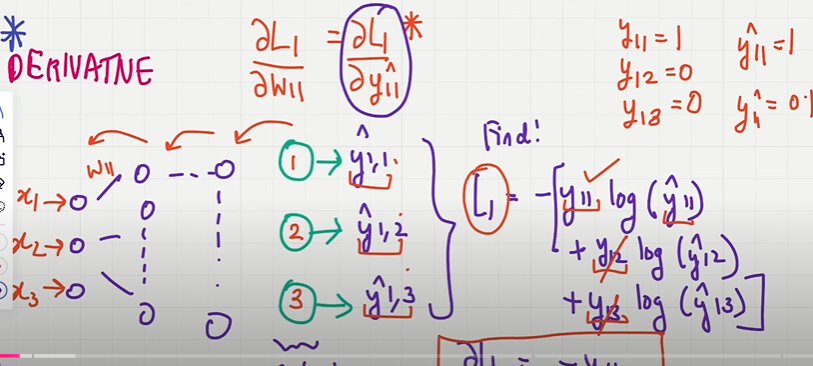

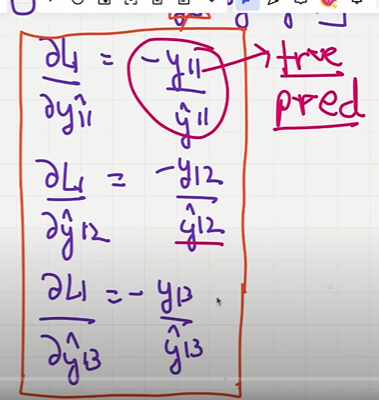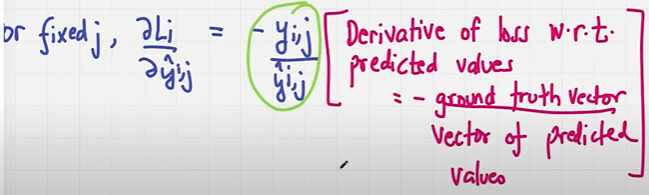

...
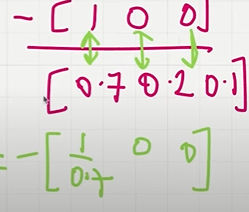

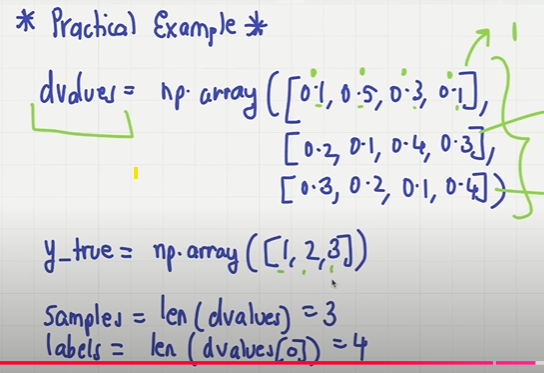

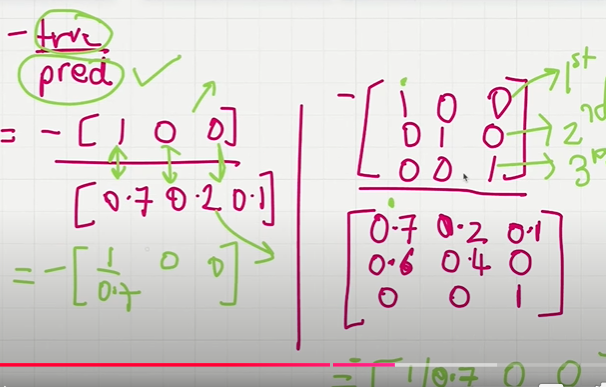

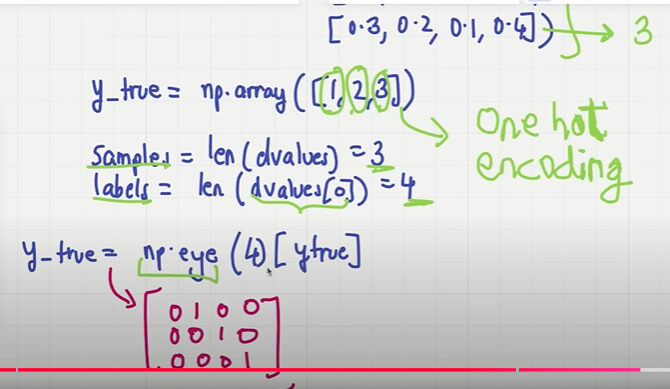

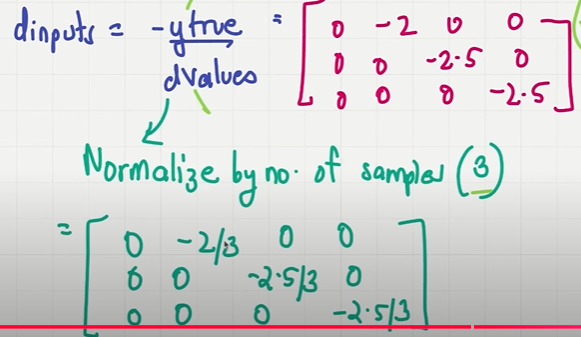

In [ ]:
# Cross-entropy loss
class Loss_CategoricalCrossentropy(Loss):
    # ...
    # Backward pass
    def backward(self, dvalues, y_true):
        # Number of samples
        samples = len(dvalues)
        # Number of labels in every sample
        # We'll use the first sample to count them
        labels = len(dvalues[0])
        # If labels are sparse, turn them into one-hot vector
        if len(y_true.shape) == 1:
             y_true = np.eye(labels)[y_true]
        # Calculate gradient
        self.dinputs = -y_true / dvalues
        # Normalize gradient
        self.dinputs = self.dinputs / samples